<a href="https://colab.research.google.com/github/Devashish1881/Anime-Face-Generation-DCGAN/blob/main/GenerativeAI_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Import some of the main Library for using this notebook.
import torch
import numpy as np
from torch import nn
from torchvision import transforms
from torchvision import datasets
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import os
from PIL import Image
import matplotlib.pyplot as plt


torch.manual_seed(0)
z_dim = 10
display_step =  500
batch_size = 128
lr = 0.0001
beta_1 = 0.5
beta_2 = 0.999
device = "cuda" if torch.cuda.is_available() else "cpu"


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!mkdir "dataset"

In [ ]:
from zipfile import ZipFile
with ZipFile('drive/MyDrive/facedataset.zip','r') as zipobj:
 zipobj.extractall('dataset/facedataset')

In [ ]:
# Custom Dataset Class
class ImageFolderDataset(torch.utils.data.Dataset):
    """
    It takes the actual dataset directory path and transforms it.

    """
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.image_filenames = os.listdir(root_dir)
        self.transform = transform

    def __getitem__(self, index):
        image_filename = self.image_filenames[index]
        image_path = os.path.join(self.root_dir, image_filename)
        image = Image.open(image_path)

        if self.transform:
            image = self.transform(image)

        return image

    def __len__(self):
        return len(self.image_filenames)


In [ ]:

transform = transforms.Compose([
    transforms.Resize((64, 64)),  # Resize the image to 64x64 pixels
    transforms.CenterCrop(64),
    transforms.ToTensor(),         # Convert the image to a PyTorch tensor
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),

])

train_dataset = ImageFolderDataset("/content/dataset/facedataset/images",transform)


In [ ]:
dataloader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True,
    drop_last=True
    )


In [ ]:
# Once the data loading part is complete then move on to
# create one function to display a batch of images or a single image.
def show_tensor_images(image_tensor, num_images=25):
    '''
    This Function for visualizing images: Given a tensor of images and a number of images
    plots and prints the images in a uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()


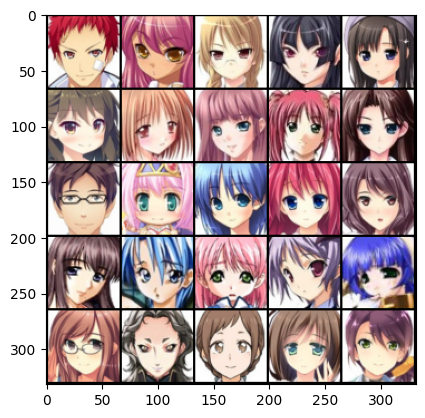

In [ ]:
sample = None
for d in dataloader:
  sample = d
  break

show_tensor_images(sample)


In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    '''
    def __init__(self, z_dim=10, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 8),
            self.make_gen_block(hidden_dim * 8, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

        self.layers_st = []


    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;

        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function is completing a forward pass input noise into generator and return genrated image.
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

    def layers(self):
      for i,layer in enumerate(self.gen):
        for l in self.gen[i]:
           self.layers_st.append(l)
      return self.layers_st


def get_noise(n_samples, z_dim, device='cpu'):

    return torch.randn(n_samples, z_dim, device=device)


In [ ]:
class Discriminator(nn.Module):
  def __init__(self,im_chan=3, hidden_dim=64):
    super(Discriminator,self).__init__()

    # Sequence of layer add
    self.disc = nn.Sequential(
        nn.Conv2d(im_chan,hidden_dim,kernel_size=4,stride=2,padding=1),
        nn.LeakyReLU(0.2,inplace=True),
        self.get_disc_group_of_layer(hidden_dim,hidden_dim*2,kernel_size=(4,4),strides=2),
        self.get_disc_group_of_layer(hidden_dim*2,hidden_dim*4,kernel_size=(4,4),strides=2),
        self.get_disc_group_of_layer(hidden_dim*4,hidden_dim*8,kernel_size=(4,4),strides=2),
        self.get_disc_group_of_layer(hidden_dim*8,1,kernel_size=(4,4),strides=1,final_layer=True),
    )

  # This is one useful function to help you to get a sequence of layers add just write oneline.
  def get_disc_group_of_layer(self,input_channels,output_channels,kernel_size=4,strides=1,final_layer=False):

    if not final_layer:
      return nn.Sequential(
          nn.Conv2d(input_channels,output_channels,kernel_size,strides,padding=(1,1)),
          nn.BatchNorm2d(output_channels),
          nn.LeakyReLU(0.2,inplace=True)
      )
    else:
      return nn.Sequential(
          nn.Conv2d(input_channels,output_channels,kernel_size,strides,padding=0),
          nn.Sigmoid()

      )


  def forward(self,x):

    """
     return as a 0 (fake) or 1 (Real).
    """
    disc_pred = self.disc(x)

    return disc_pred


In [ ]:
# Generator Model or object create set to device
gen = Generator().to(device)
gen_opt = torch.optim.Adam(gen.parameters(),lr=lr,betas=(beta_1, beta_2))
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(),lr=lr,betas=(beta_1, beta_2))

def weights_init(m):
    """
    This down-below function works for initializing the weight of the convolution layer and Batch normalization
    layer in PyTorch.
    """
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# Apply the weights init function to initalize layer weight.
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)


step: 0, epoch: 0, Disc Loss: 1.405902624130249, Gen Loss: 0.7415392398834229


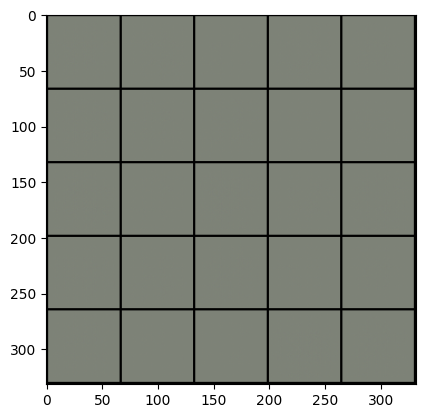

step: 0, epoch: 1, Disc Loss: 0.05801248550415039, Gen Loss: 4.753649711608887


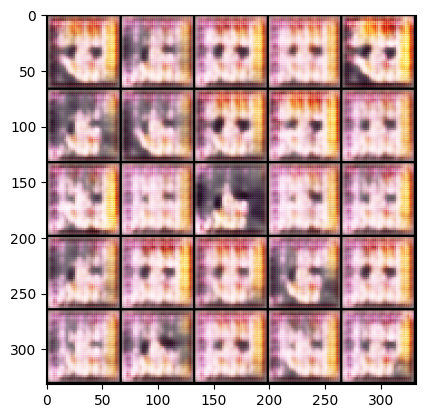

step: 0, epoch: 2, Disc Loss: 0.4442143440246582, Gen Loss: 2.815894603729248


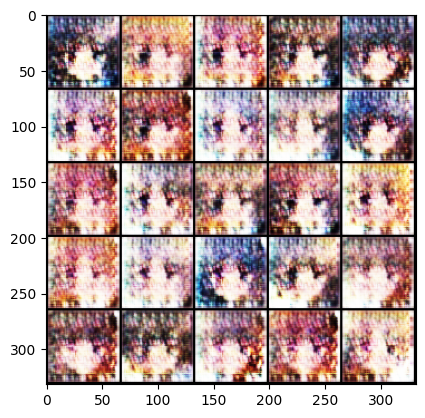

step: 0, epoch: 3, Disc Loss: 0.5658956170082092, Gen Loss: 2.6769068241119385


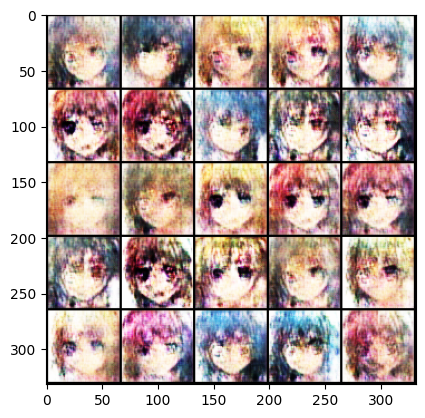

step: 0, epoch: 4, Disc Loss: 0.602273166179657, Gen Loss: 2.271160125732422


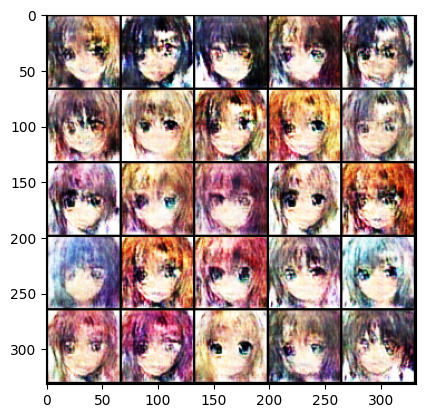

step: 0, epoch: 5, Disc Loss: 0.7958928942680359, Gen Loss: 1.3328542709350586


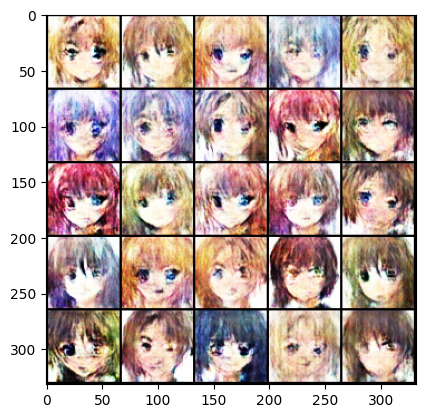

step: 0, epoch: 6, Disc Loss: 0.5394705533981323, Gen Loss: 2.3888230323791504


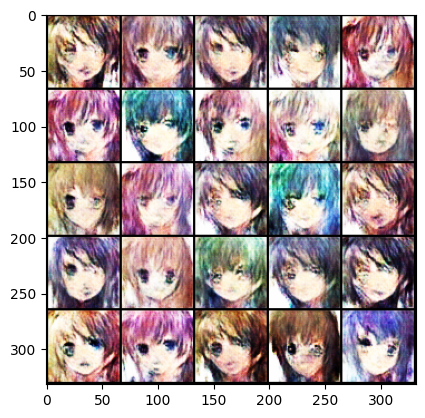

step: 0, epoch: 7, Disc Loss: 0.6438073515892029, Gen Loss: 1.6063320636749268


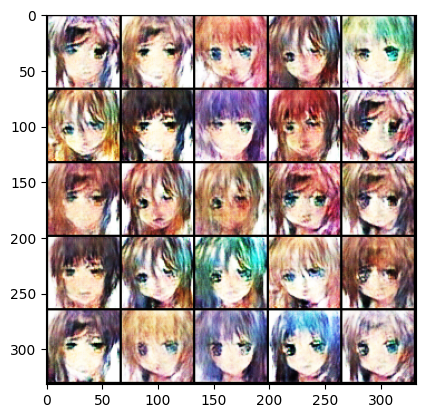

step: 0, epoch: 8, Disc Loss: 0.41641873121261597, Gen Loss: 2.4119014739990234


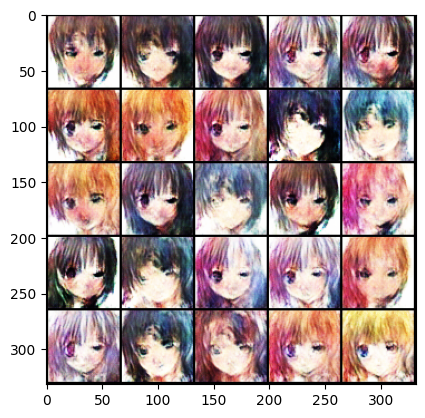

step: 0, epoch: 9, Disc Loss: 0.19835548102855682, Gen Loss: 3.115687370300293


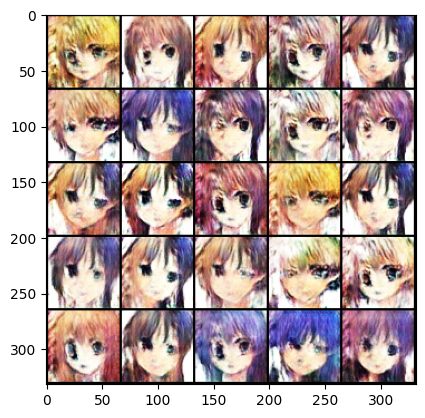

step: 0, epoch: 10, Disc Loss: 0.33896955847740173, Gen Loss: 5.586332321166992


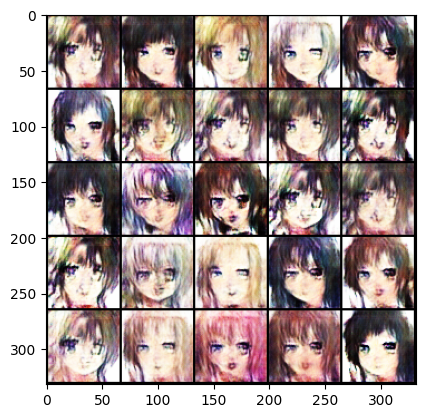

step: 0, epoch: 11, Disc Loss: 0.29018497467041016, Gen Loss: 5.270931243896484


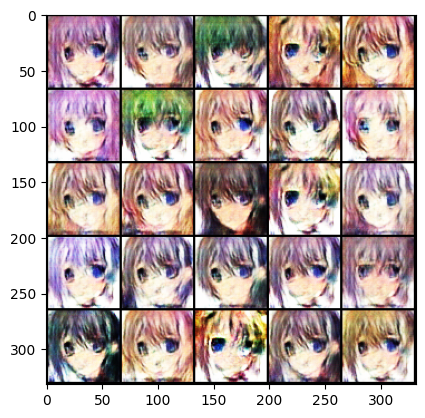

step: 0, epoch: 12, Disc Loss: 0.19739621877670288, Gen Loss: 4.396060943603516


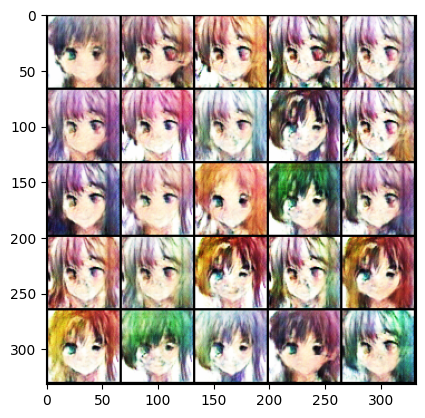

step: 0, epoch: 13, Disc Loss: 0.14854471385478973, Gen Loss: 4.100208282470703


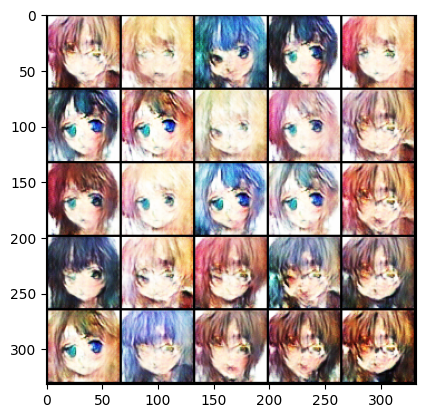

step: 0, epoch: 14, Disc Loss: 0.1406077742576599, Gen Loss: 5.070246696472168


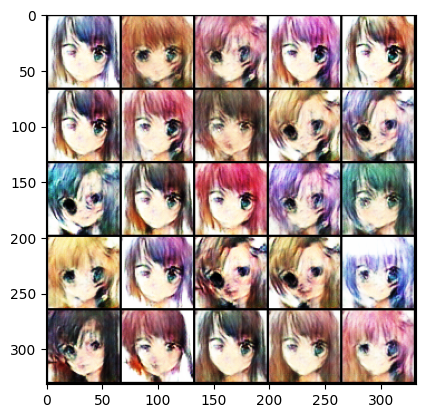

step: 0, epoch: 15, Disc Loss: 0.08213631063699722, Gen Loss: 5.3506364822387695


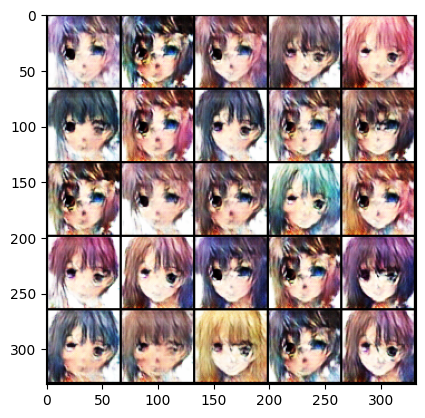

step: 0, epoch: 16, Disc Loss: 0.1708502471446991, Gen Loss: 6.010829925537109


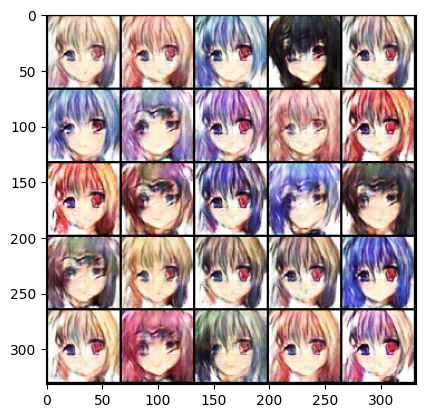

step: 0, epoch: 17, Disc Loss: 0.26656338572502136, Gen Loss: 3.087559938430786


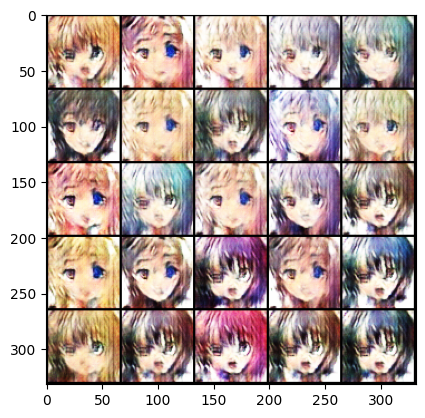

step: 0, epoch: 18, Disc Loss: 0.11948104202747345, Gen Loss: 4.332796096801758


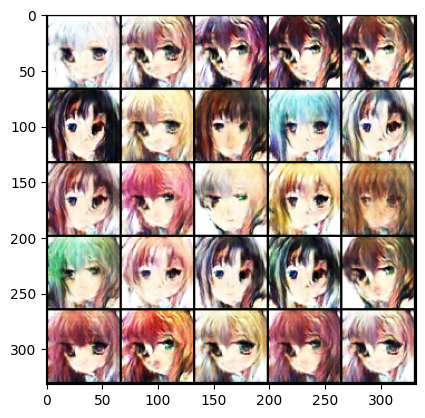

step: 0, epoch: 19, Disc Loss: 0.10606512427330017, Gen Loss: 4.384161949157715


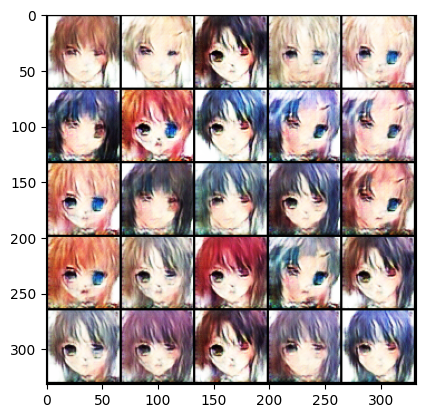

step: 0, epoch: 20, Disc Loss: 0.11558978259563446, Gen Loss: 4.239198207855225


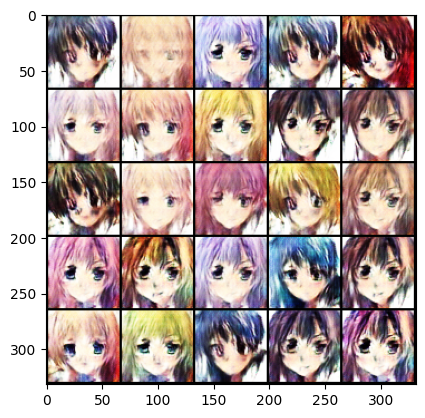

step: 0, epoch: 21, Disc Loss: 0.131809800863266, Gen Loss: 4.403961181640625


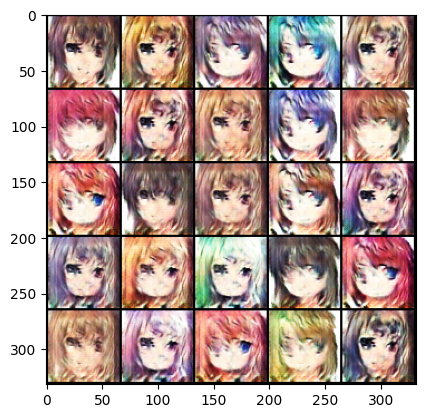

step: 0, epoch: 22, Disc Loss: 0.07132576406002045, Gen Loss: 6.109591484069824


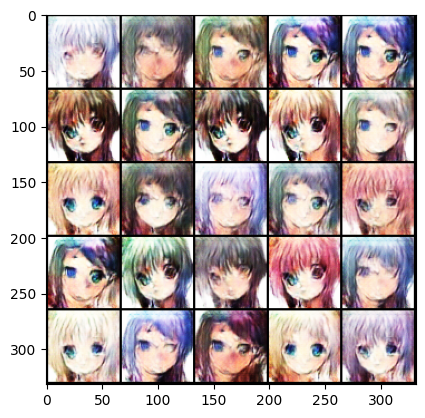

step: 0, epoch: 23, Disc Loss: 0.06573060154914856, Gen Loss: 5.090488910675049


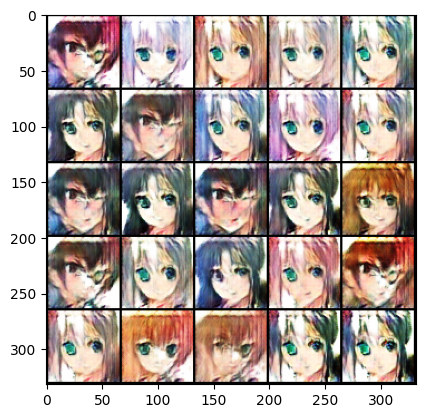

step: 0, epoch: 24, Disc Loss: 0.08714692294597626, Gen Loss: 4.376782417297363


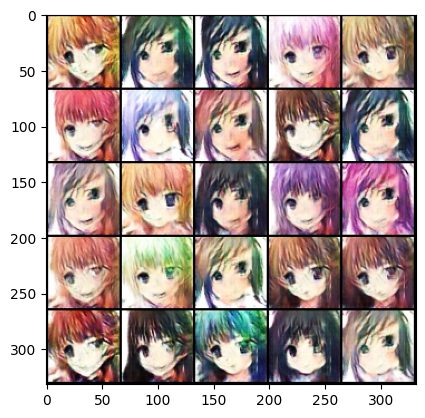

step: 0, epoch: 25, Disc Loss: 0.0871628001332283, Gen Loss: 4.955678939819336


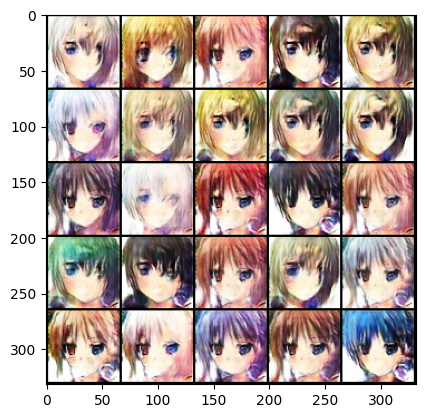

step: 0, epoch: 26, Disc Loss: 0.3679369390010834, Gen Loss: 3.530094861984253


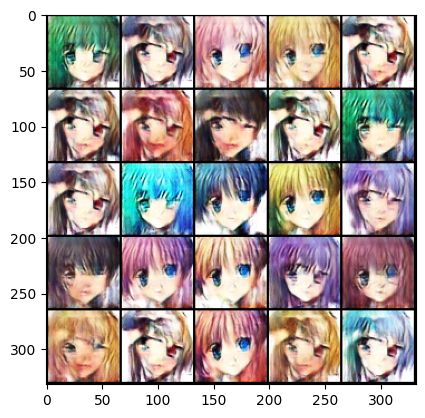

step: 0, epoch: 27, Disc Loss: 0.05212889611721039, Gen Loss: 5.289626121520996


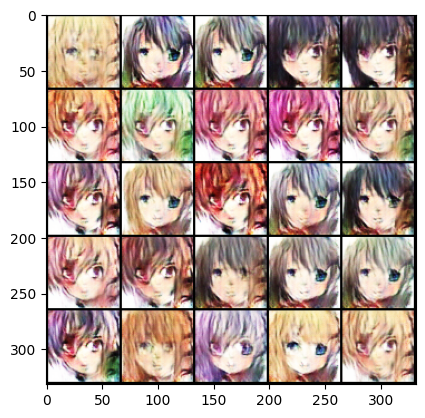

step: 0, epoch: 28, Disc Loss: 0.0641641616821289, Gen Loss: 4.104303359985352


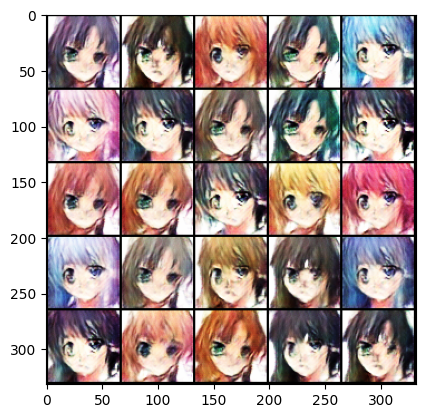

step: 0, epoch: 29, Disc Loss: 0.07326754927635193, Gen Loss: 6.4421772956848145


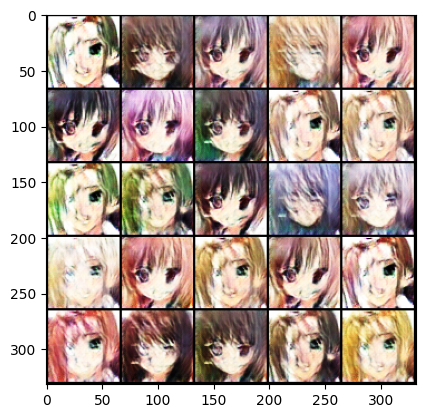

step: 0, epoch: 30, Disc Loss: 0.034504592418670654, Gen Loss: 5.46591329574585


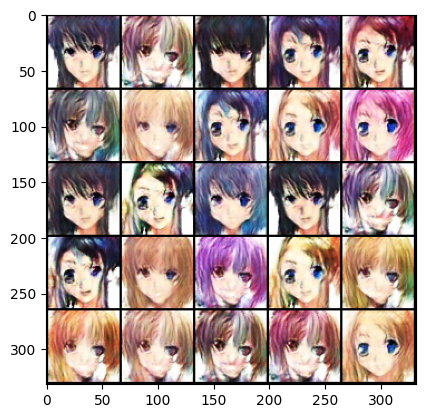

step: 0, epoch: 31, Disc Loss: 0.01880771480500698, Gen Loss: 3.218667984008789


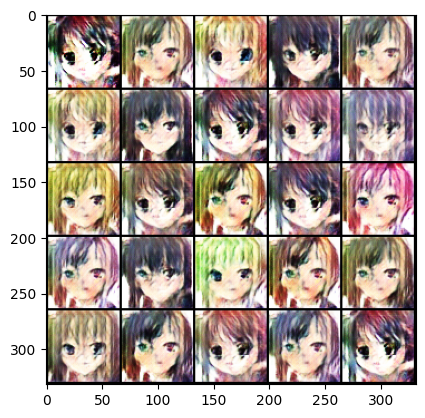

step: 0, epoch: 32, Disc Loss: 0.08030261099338531, Gen Loss: 5.585069179534912


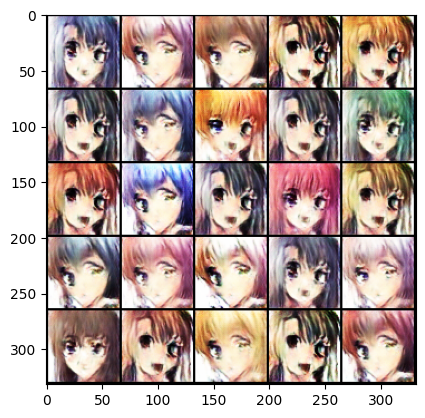

step: 0, epoch: 33, Disc Loss: 0.17711445689201355, Gen Loss: 10.12812614440918


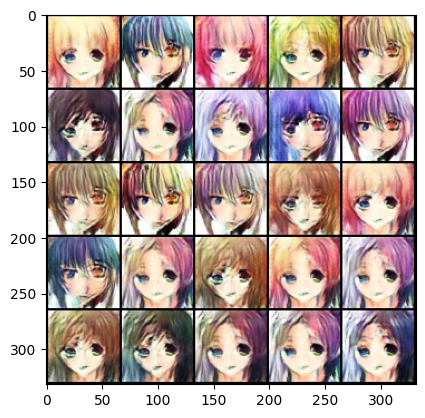

step: 0, epoch: 34, Disc Loss: 0.07877051830291748, Gen Loss: 5.667500019073486


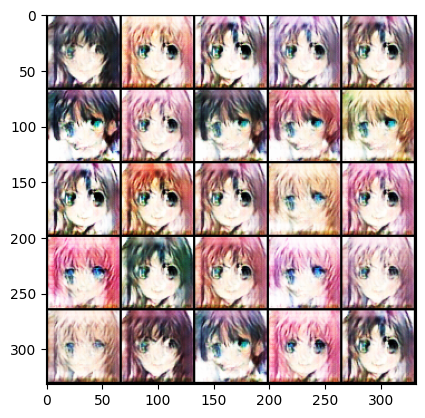

step: 0, epoch: 35, Disc Loss: 0.07402434945106506, Gen Loss: 5.034083843231201


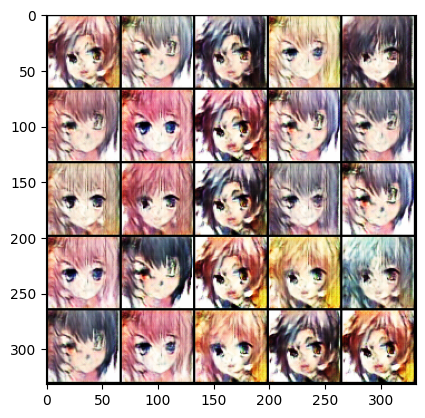

step: 0, epoch: 36, Disc Loss: 0.2826409935951233, Gen Loss: 6.381549835205078


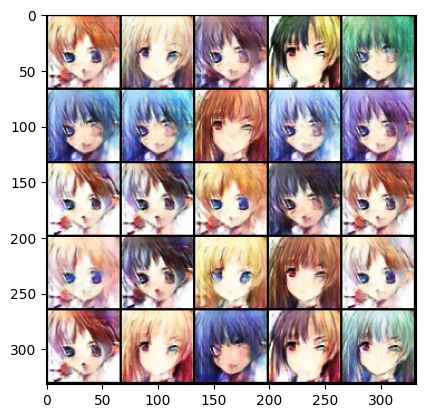

step: 0, epoch: 37, Disc Loss: 0.04516822099685669, Gen Loss: 6.605151176452637


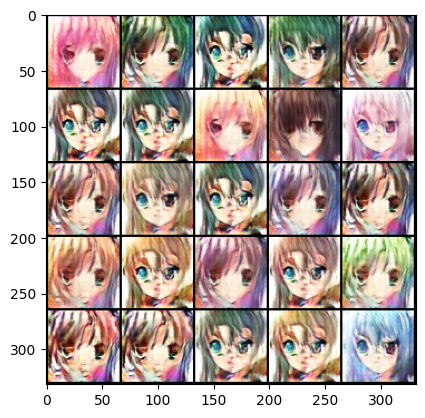

step: 0, epoch: 38, Disc Loss: 0.328807532787323, Gen Loss: 12.584894180297852


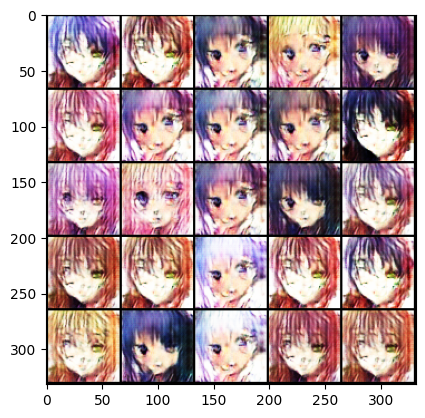

step: 0, epoch: 39, Disc Loss: 1.2252250909805298, Gen Loss: 22.43323516845703


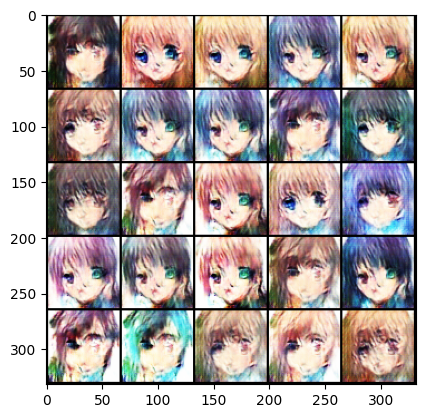

step: 0, epoch: 40, Disc Loss: 0.22916379570960999, Gen Loss: 5.968430519104004


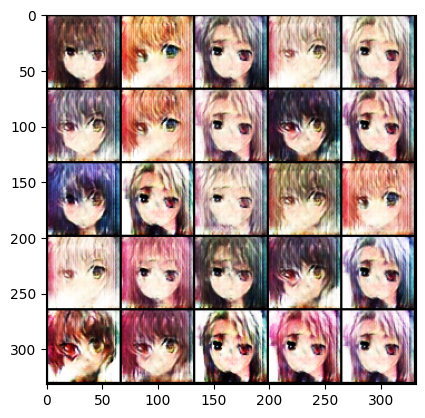

step: 0, epoch: 41, Disc Loss: 0.04685318097472191, Gen Loss: 6.265348434448242


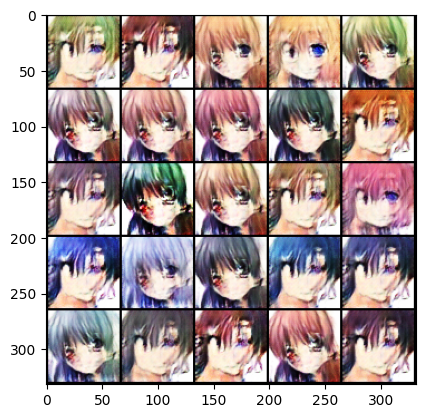

step: 0, epoch: 42, Disc Loss: 0.03897511586546898, Gen Loss: 5.696429252624512


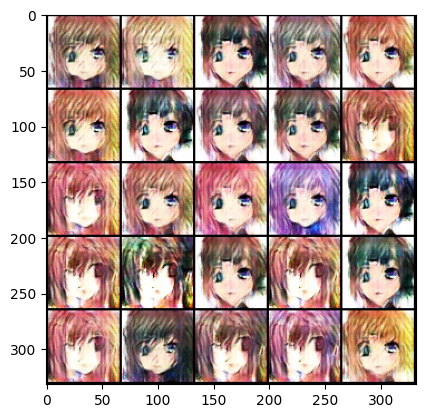

step: 0, epoch: 43, Disc Loss: 0.3069731593132019, Gen Loss: 7.941247940063477


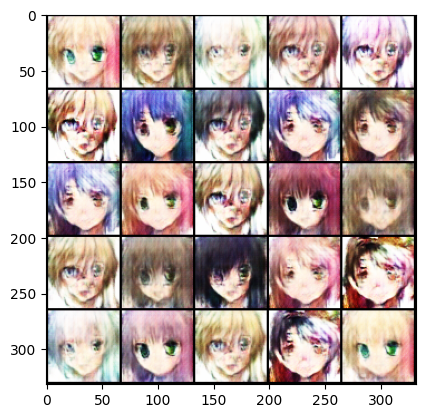

step: 0, epoch: 44, Disc Loss: 0.16612744331359863, Gen Loss: 10.38479232788086


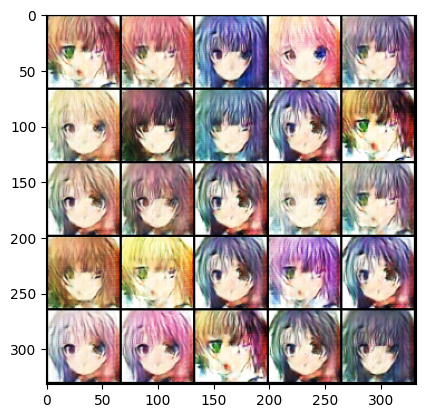

step: 0, epoch: 45, Disc Loss: 0.029212530702352524, Gen Loss: 5.135906219482422


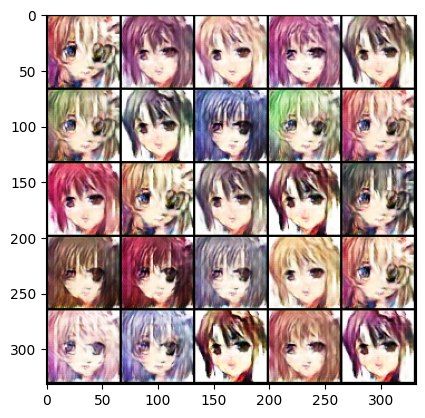

step: 0, epoch: 46, Disc Loss: 0.22809740900993347, Gen Loss: 8.488601684570312


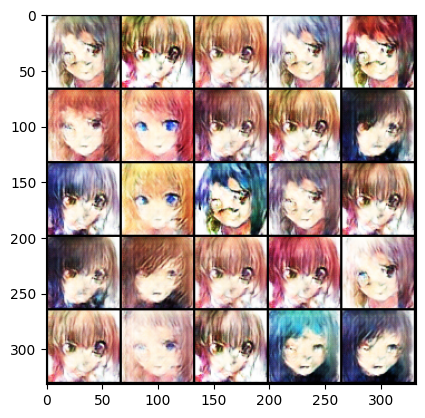

step: 0, epoch: 47, Disc Loss: 0.03730796277523041, Gen Loss: 7.092600345611572


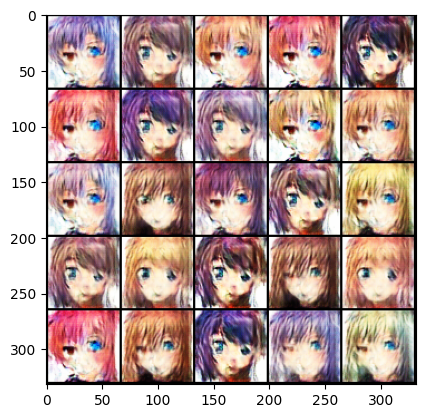

step: 0, epoch: 48, Disc Loss: 0.10068877786397934, Gen Loss: 5.581775665283203


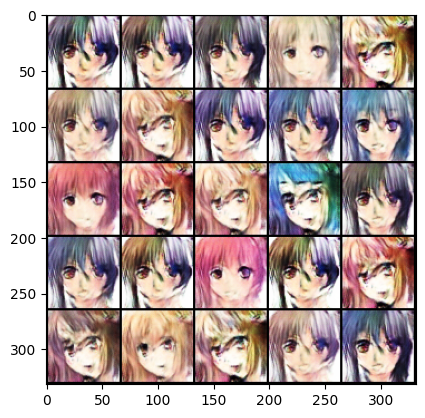

step: 0, epoch: 49, Disc Loss: 0.07354840636253357, Gen Loss: 5.530019760131836


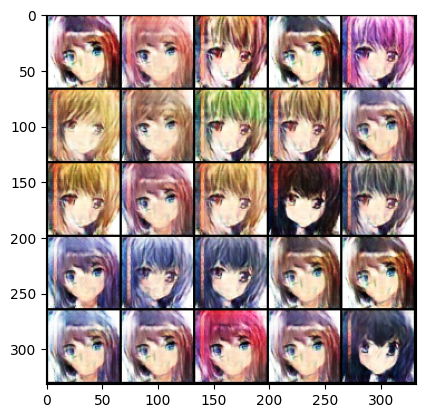

step: 0, epoch: 50, Disc Loss: 0.040672678500413895, Gen Loss: 5.875032424926758


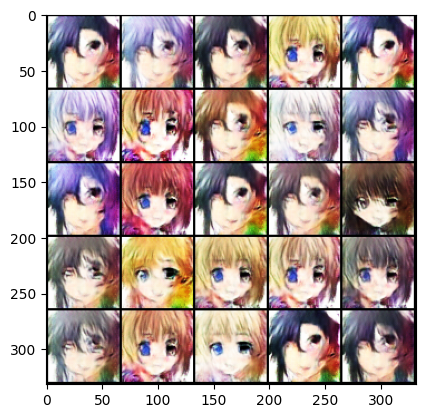

step: 0, epoch: 51, Disc Loss: 0.2567428648471832, Gen Loss: 4.8415398597717285


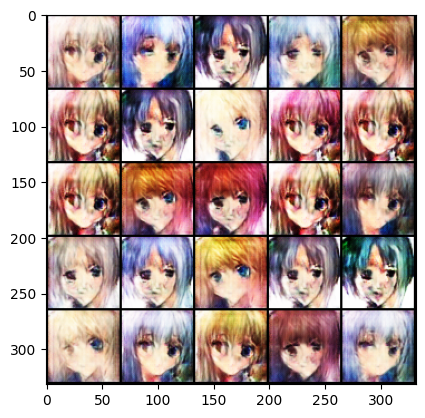

step: 0, epoch: 52, Disc Loss: 0.042650867253541946, Gen Loss: 6.592977523803711


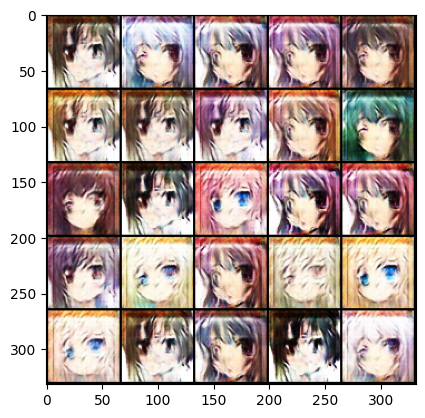

step: 0, epoch: 53, Disc Loss: 0.11103219538927078, Gen Loss: 8.028078079223633


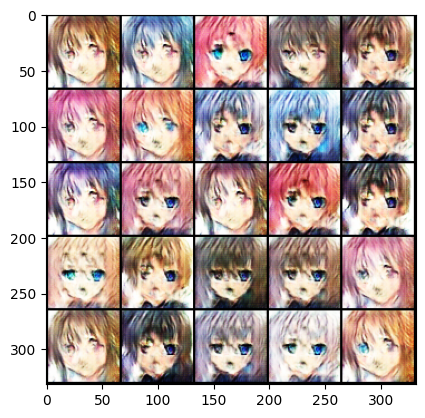

step: 0, epoch: 54, Disc Loss: 0.006473164539784193, Gen Loss: 7.92046594619751


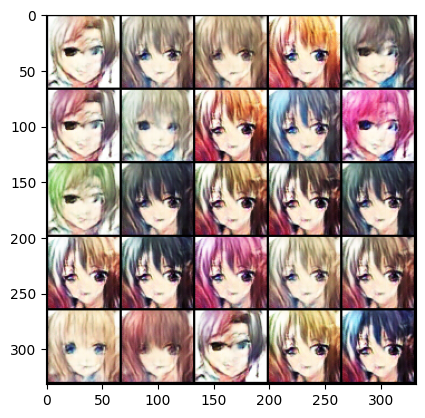

step: 0, epoch: 55, Disc Loss: 0.3117031157016754, Gen Loss: 2.1607937812805176


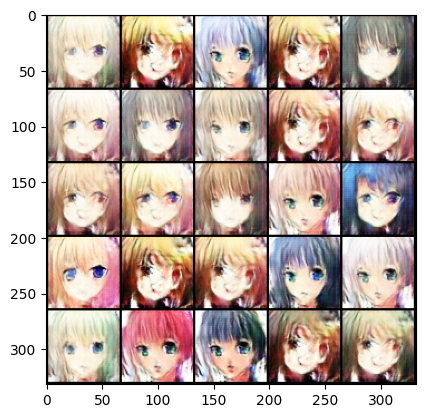

step: 0, epoch: 56, Disc Loss: 0.04787233844399452, Gen Loss: 5.6192402839660645


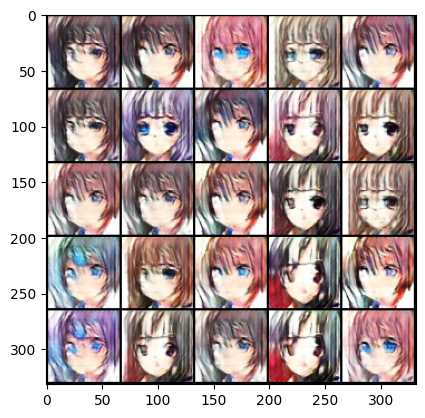

step: 0, epoch: 57, Disc Loss: 0.034740135073661804, Gen Loss: 5.652734279632568


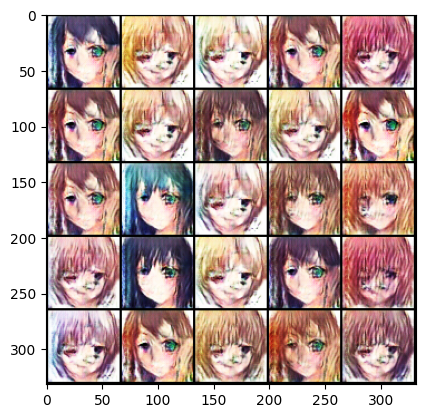

step: 0, epoch: 58, Disc Loss: 0.030302125960588455, Gen Loss: 5.928916931152344


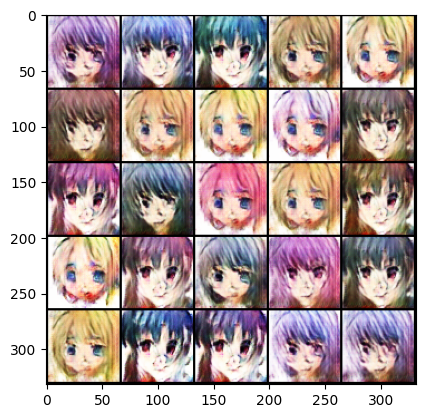

step: 0, epoch: 59, Disc Loss: 0.0269770510494709, Gen Loss: 5.564754486083984


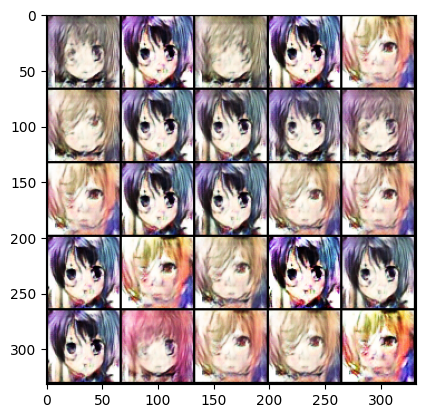

step: 0, epoch: 60, Disc Loss: 0.036611005663871765, Gen Loss: 5.740256309509277


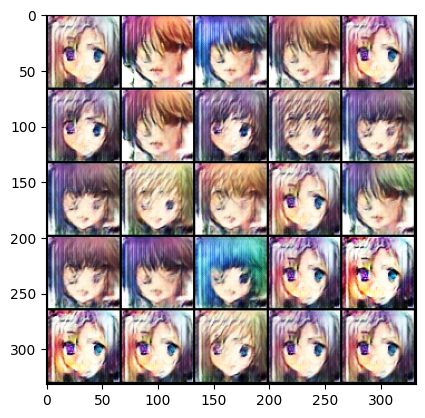

step: 0, epoch: 61, Disc Loss: 0.03577787056565285, Gen Loss: 5.330481052398682


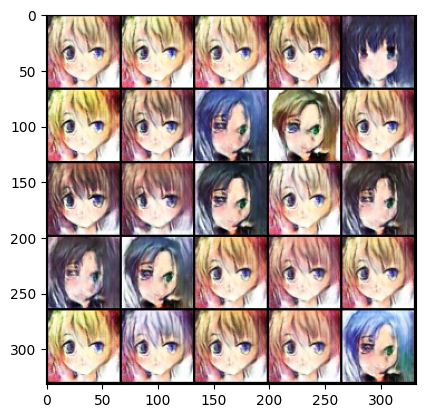

step: 0, epoch: 62, Disc Loss: 0.036485422402620316, Gen Loss: 5.64869499206543


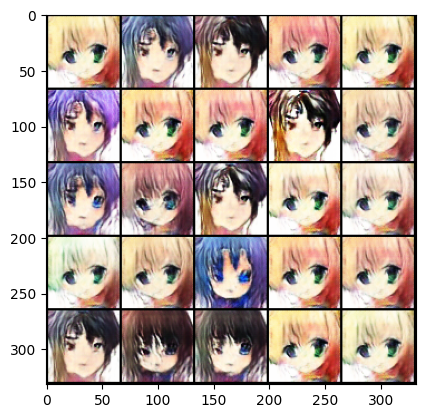

step: 0, epoch: 63, Disc Loss: 0.12065847963094711, Gen Loss: 6.422146797180176


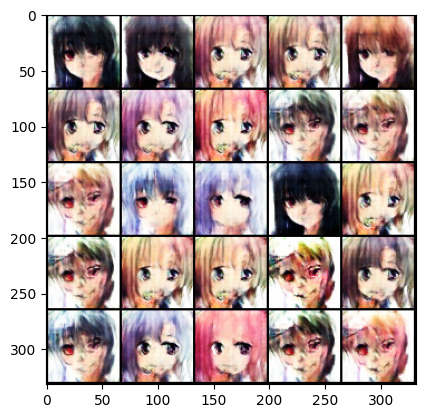

step: 0, epoch: 64, Disc Loss: 0.057666826993227005, Gen Loss: 3.920616865158081


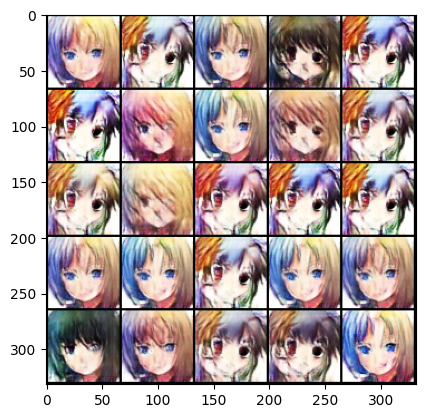

step: 0, epoch: 65, Disc Loss: 0.02084365300834179, Gen Loss: 5.74129581451416


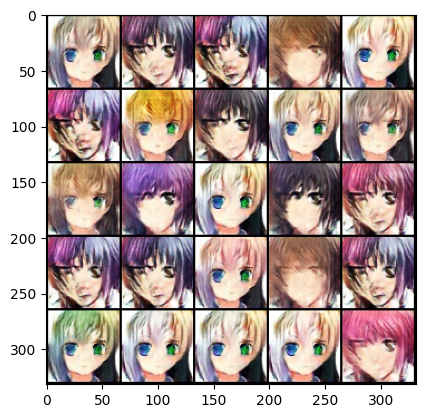

step: 0, epoch: 66, Disc Loss: 0.008876838721334934, Gen Loss: 8.84107780456543


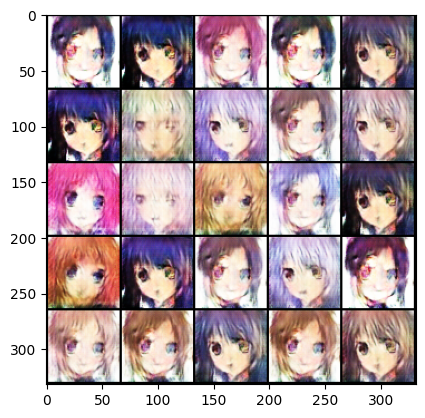

step: 0, epoch: 67, Disc Loss: 0.04652485251426697, Gen Loss: 6.153406143188477


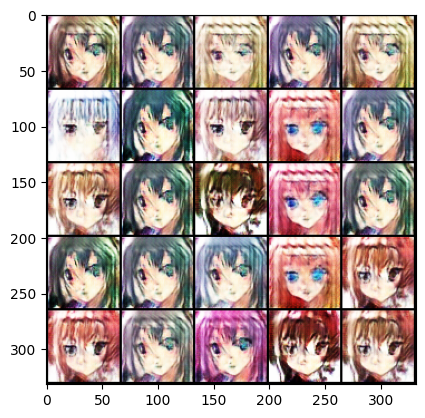

step: 0, epoch: 68, Disc Loss: 0.09082680195569992, Gen Loss: 6.53875207901001


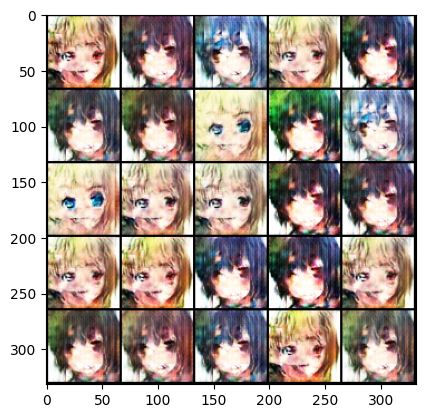

step: 0, epoch: 69, Disc Loss: 0.01028269249945879, Gen Loss: 5.8716888427734375


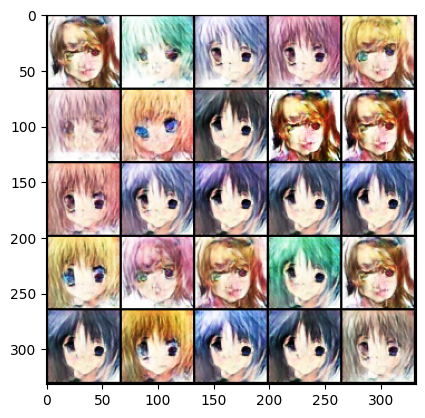

In [ ]:
criterion = nn.BCELoss()
n_epochs = 70
for epoch in range(n_epochs):
  for i, data in enumerate(dataloader):
    gen.train()
    disc.train()
    # Upgrade Discriminator Weights
    disc.zero_grad()
    actual_image = data.to(device)
    b_size = actual_image.size(0)
    label = torch.full((b_size,),1. ,dtype=torch.float,device=device )
    real_pred = disc(actual_image).view(-1)
    real_loss = criterion(real_pred, label)
    real_loss.backward()

    noise = get_noise(b_size,z_dim,device)
    fake_image = gen(noise)
    label.fill_(0.)
    fake_pred = disc(fake_image.detach()).view(-1)
    fake_loss = criterion(fake_pred,label)
    fake_loss.backward()

    disc_loss = real_loss + fake_loss
    disc_opt.step()

    # Upgrade Generative neural network
    gen.zero_grad()
    label.fill_(1.)
    fake_disc = disc(fake_image).view(-1)
    fake_gen_loss = criterion(fake_disc,label)
    fake_gen_loss.backward()
    gen_opt.step()
    if i% display_step == 0:
      print(f"step: {i}, epoch: {epoch}, Disc Loss: {disc_loss.item()}, Gen Loss: {fake_gen_loss.item()}")
      output = gen(noise).detach()
      # save model
      torch.save(obj=gen.state_dict(),f="cartoon_gan.pth")
      torch.save(obj=disc.state_dict(),f="cartoon_detect.pth")
      show_tensor_images(output)

